# Download the spectra for each source

In [1]:
%matplotlib inline
import sys, os, glob, copy, re, shutil

from astropy.io import fits, ascii
import numpy as np
import matplotlib.pyplot as plt
from astropy import units as u
import astropy.constants as const
from astropy.coordinates import SkyCoord, concatenate
from astropy import table
from astropy.convolution import Box1DKernel, convolve
from astroquery.sdss import SDSS
from astropy.wcs import WCS

from astropy.io import fits

import scienceplots

plt.style.use(['bright', 'science', 'no-latex','notebook'])

read tables 

**This notebook does not change these tables**

In [2]:
data_agn_updated = ascii.read('hsc_agn_updated.txt')
data_agn = ascii.read('hsc_agn.txt')

ra, dec = data_agn_updated['RAdeg'], data_agn_updated['DEdeg']
data_coords = SkyCoord(ra, dec, unit=[u.deg, u.deg])

prepare a table for downloading flag (?) 

In [3]:
data_agn_download = copy.deepcopy(data_agn_updated)

plot the table in a skymap

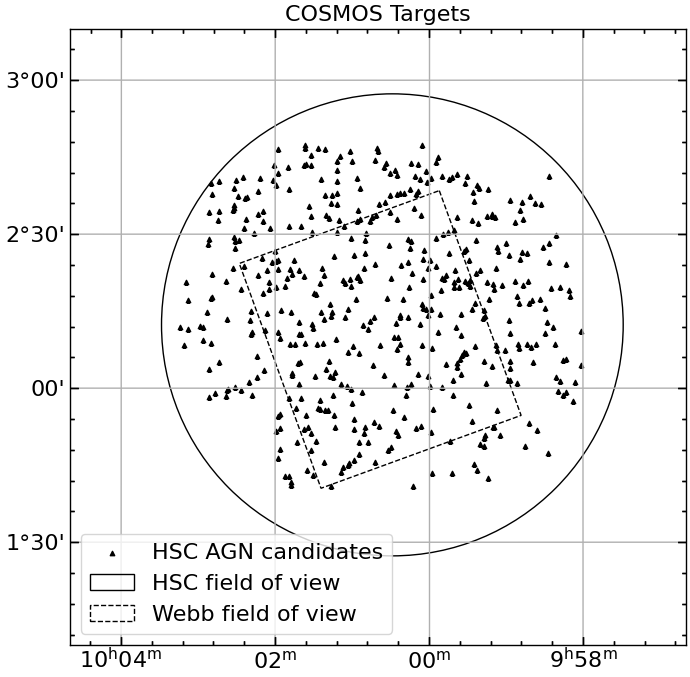

In [4]:
center_coord = SkyCoord("150d10m 2d10m")
width = 1*u.deg

wcs = WCS(naxis=2)
wcs.wcs.crpix = [1, 1]
wcs.wcs.cdelt = [-width.to_value(u.deg), width.to_value(u.deg)]
wcs.wcs.crval = [center_coord.ra.deg, center_coord.dec.deg]
wcs.wcs.ctype = ["RA---TAN", "DEC--TAN"]

fig = plt.figure(figsize=[8, 8], dpi=100)
ax1 = plt.axes(projection=wcs)
ax1.set_aspect('equal')

ax1.scatter(ra, dec, transform=ax1.get_transform('world'), s=10, marker='^', color='k', alpha=1, label='HSC AGN candidates')

# Add FOVs
#HSC: 10.1093/pasj/psx066 fig4
HSC_center = SkyCoord('10h00m28.60s +02d12m21.00s')
HSC_radius = 0.75
HSC_FOV = plt.Circle((HSC_center.ra.value, HSC_center.dec.value), HSC_radius, 
                        fill=False, transform=ax1.get_transform('world'), label='HSC field of view')
ax1.add_artist(HSC_FOV)
#Webb: 2211.07865 fig1
Webb_center = SkyCoord('10h00m27.9s +02d12m03.5s')
Webb_width = 41.5/60
Webb_height = 46.6/60
Webb_angle = 110
Webb_FOV = plt.Rectangle((Webb_center.ra.value-Webb_width/2, Webb_center.dec.value-Webb_height/2),  
                        Webb_height, Webb_width, rotation_point='center', angle=-110, linestyle='--',
                        fill=False, transform=ax1.get_transform('world'), label='Webb field of view')
ax1.add_artist(Webb_FOV)

ax1.grid()
ax1.coords['ra'].set_auto_axislabel(False)
ax1.coords['dec'].set_auto_axislabel(False)
ax1.legend(loc='lower left', frameon=True)
ax1.set_title('COSMOS Targets')
ax1.set_xlim(-1, 1) # using deg as unit as defined in wcs.wcs.cdelt
ax1.set_ylim(-1, 1)

plt.show()

### Dataset overview

The following sources have a publically available spectra

* Magellean/zCOSMOS
* DEIMOS
* SDSS

The following sources need more inspection: 

* HSC PDR3: it consists of many sources that may or may not be available


## Magellan

inquiry website: https://irsa.ipac.caltech.edu/data/COSMOS/

We first download all the spectra and match it into our catalog. 

Put `150.15 2.25` into `Coordinates/Object`, `2` into `Image Search Size (deg)` (whatever but `2` runs the fastest), `0.75 deg` into `Source Search Radius`, check `Images must cover coordinate`and uncheck `Match with image search size`, and submit, and then download `magellan_opt_spec_30.tbl`. It contains all the coordinates and links of the spectra we may want to use. 

Then, we match it into our catalog. 

In [5]:
magellean_targets = ascii.read('spec/magellan_opt_spec_30.tbl')
# prettify
pattern = re.compile(r'.*href="(.*)" target.*')
for i in range(len(magellean_targets)): 
    for key in ['TBL', 'FITS', 'SPEC_Preview_JPG']: 
        magellean_targets[key][i] = pattern.findall(magellean_targets[key][i])[0]

magellean_coords = SkyCoord(magellean_targets['ra'], magellean_targets['dec'], unit=[u.deg, u.deg])
idx_magellean, idx_data, d2d, _ = data_coords.search_around_sky(magellean_coords, 0.5*u.arcsec)

len(idx_magellean), len(np.unique(idx_data))

(205, 204)

Fill in the downloading table. 

In [6]:
data_agn_download['spec_magellan'] = False
data_agn_download['z_magellan'] = -1.

for i in range(len(idx_data)): 
    data_agn_download['spec_magellan'][idx_data[i]] = True
    data_agn_download['z_magellan'][idx_data[i]] = magellean_targets['redshift'][idx_magellean][i]

Download the data. The whole precess takes ~2 mins. 

Naming convention: `magellean_<ID>.fits` (ID not index)

In [7]:
# magellean_dir = 'spec/Magellan'
# magellean_id = data_agn_download[idx_data]['ID']
# magellean_links = magellean_targets[idx_magellean]['FITS']

# for i in range(len(magellean_id)): 
#     os.system('wget '+magellean_links[i]+' -O '+os.path.join(magellean_dir, 'magellan_'+str(magellean_id[i])+'.fits'))

# # manually clear output after downloading

Note: 

* Magellan has 205/1240 targets matched, which is less than zCOSMOS has 236/20098 matches. 
* ID=153 has multiple returns, checked below and sample spectra section 
  * The two matches have the same spectra link, which supports z=0.695

## zCOSMOS

In [8]:
zcosmos_targets = ascii.read('spec/zcosmosdr3.tbl')
# prettify
pattern = re.compile(r'.*href="(.*)" target.*')
for i in range(len(zcosmos_targets)): 
    for key in ['Spectrum_FITS', 'Spectrum_TBL', 'Spectrum_Preview', 'HST_stamp_jpg', 'HST_stamp_fits']: 
        zcosmos_targets[key][i] = pattern.findall(zcosmos_targets[key][i])[0]

zcosmos_coords = SkyCoord(zcosmos_targets['ra'], zcosmos_targets['dec'], unit=[u.deg, u.deg])
idx_zcosmos, idx_data, d2d, _ = data_coords.search_around_sky(zcosmos_coords, 0.5*u.arcsec)

len(idx_zcosmos), len(np.unique(idx_data))

(236, 236)

Fill the flag in the downloading table. 

In [9]:
data_agn_download['spec_zcosmos'] = False

for i in range(len(idx_data)): 
    data_agn_download['spec_zcosmos'][idx_data[i]] = True

Download the data. The whole precess takes ~3 mins. UNCOMMENT IF YOU NEED TO DOWNLOAD AGAIN. 

Naming convention: `zcosmos_<ID>.fits` (ID not index)

In [10]:
# zcosmos_dir = 'spec/zCOSMOS'
# zcosmos_id = data_agn_download[idx_data]['ID']
# zcosmos_links = zcosmos_targets[idx_zcosmos]['Spectrum_FITS']

# for i in range(len(zcosmos_id)): 
#     os.system('wget '+zcosmos_links[i]+' -O '+os.path.join(zcosmos_dir, 'zcosmos_'+str(zcosmos_id[i])+'.fits'))

Now we fetch the redshift. The redshift is recorded in a catalog table, but this is shorter than the spectra table. 

In [11]:
zcosmos_bright_targets = ascii.read('spec/zCOSMOS_BRIGHT_v3.5_spec.tbl')

zcosmos_bright_coords = SkyCoord(zcosmos_bright_targets['ra'], zcosmos_bright_targets['dec'], unit=[u.deg, u.deg])
idx_zcosmos_bright, idx_data, d2d, _ = data_coords.search_around_sky(zcosmos_bright_coords, 0.5*u.arcsec)

len(idx_zcosmos_bright), len(np.unique(idx_data))

(153, 153)

In [12]:
data_agn_download['z_zcosmos'] = -1.

for i in range(len(idx_data)): 
    if zcosmos_bright_targets['z'][idx_zcosmos_bright[i]] not in [9.9999, .0]: 
        data_agn_download['z_zcosmos'][idx_data[i]] = zcosmos_bright_targets['z'][idx_zcosmos_bright][i]

## DEIMOS

The data retrieval is as same as zCOSMOS, but download `deimos_redshift_linksIRSA.tbl`. 

DEIMOS table contains possible spec-z value.

In [13]:
deimos_targets = ascii.read('spec/deimos_redshift_linksIRSA.tbl')
# prettify
deimos_targets = deimos_targets[deimos_targets['fits1d']!='null']
pattern = re.compile(r'.*href="(.*)">.*')
for i in range(len(deimos_targets)): 
    for key in ['fits1d']: #, 'ascii1d', 'jpg1d', 'fits2d']: 
        # print(i, key)
        deimos_targets[key][i] = 'https://irsa.ipac.caltech.edu' + pattern.findall(deimos_targets[key][i])[0]

deimos_coords = SkyCoord(deimos_targets['ra'], deimos_targets['dec'], unit=[u.deg, u.deg])
idx_deimos, idx_data, d2d, _ = data_coords.search_around_sky(deimos_coords, 0.5*u.arcsec)

len(idx_deimos), len(np.unique(idx_data))

(118, 118)

Update the downloading flag table 

In [14]:
data_agn_download['spec_deimos'] = False
data_agn_download['z_deimos'] = -1.

for i in range(len(idx_data)): 
    data_agn_download['spec_deimos'][idx_data[i]] = True
    if deimos_targets['zspec'][idx_deimos[i]] not in ['0', 'NA']: 
        data_agn_download['z_deimos'][idx_data[i]] = deimos_targets['zspec'][idx_deimos][i]

Download the data. The whole precess takes ~2 mins. 
Naming convention: `deimos_<ID>.fits` (ID not index)

In [15]:
# deimos_dir = 'spec/DEIMOS'
# deimos_id = data_agn_download[idx_data]['ID']
# deimos_links = deimos_targets[idx_deimos]['fits1d']

# for i in range(len(deimos_id)): 
#     print(i)
#     os.system('wget '+deimos_links[i]+' -q -O '+os.path.join(deimos_dir, 'deimos_'+str(deimos_id[i])+'.fits'))

# # manually clear output after downloading

## 3D-HST

First have to download the tar files from stsci (50GB), then match to the master catalog. Then, get the filepath in the tar files from the master catalog and upload the 1D spectra to box.

Master catalog: https://cdsarc.cds.unistra.fr/ftp/J/ApJS/214/24/3dhst_master.phot.v4.1/

Tar files with spectra: https://archive.stsci.edu/prepds/3d-hst/

In [16]:
# Read master catalog
# hst3d_dir = '/Users/colinburke/Downloads'
hst3d_dir = './spec/'

# master_filepath = '/Users/colinburke/Downloads/3dhst_master.phot.v4.1.cat.FITS'
master_filepath = './3dhst_master.phot.v4.1.cat.FITS'
hdul_master = fits.open(os.path.join(hst3d_dir,master_filepath)) 

mask_cosmos = hdul_master[1].data['field']=='COSMOS'
hst3d_coords = SkyCoord(hdul_master[1].data['ra'][mask_cosmos], hdul_master[1].data['dec'][mask_cosmos], unit='deg')

# Match
idx_hst3d, idx_data, d2d, _ = data_coords.search_around_sky(hst3d_coords, 0.5*u.arcsec)

print(len(idx_hst3d), len(np.unique(idx_data)))

# WFC
#cat_filepath = 'COSMOS_WFC3_V4.1.5/cosmos_3dhst_v4.1.5_catalogs/cosmos_3dhst.v4.1.5.zfit.concat.fits'
cat_filepath = 'cosmos_3dhst_v4.1.5_catalogs/cosmos_3dhst.v4.1.5.zfit.concat.fits'
hdul = fits.open(os.path.join(hst3d_dir,cat_filepath))

filenames = []
indexes = []
indx_hsc = []

for j,i in enumerate(idx_hst3d):
    
    mask = hdul[1].data['phot_id']==hdul_master[1].data['id'][i]    
    specids = hdul[1].data['grism_id'][mask]
                
    # WFC3
    if len(specids) > 0: # If a spectrum exists
        for specid in specids:
            tile = specid[:9]
            filepath = f'COSMOS_WFC3_V4.1.5/{tile}/1D/FITS/{specid}.1D.fits'
            filenames.append(f'{specid}.1D.fits')
            indexes.append(i)
            indx_hsc.append(idx_data[j])
            print(filepath)

hst3d_targets = table.Table([indx_hsc, indexes, filenames], names=['idx_hsc','idx', 'name'])

22 22
COSMOS_WFC3_V4.1.5/cosmos-14/1D/FITS/cosmos-14-G141_03243.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-06/1D/FITS/cosmos-06-G141_05183.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-13/1D/FITS/cosmos-13-G141_05183.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-19/1D/FITS/cosmos-19-G141_05224.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-06/1D/FITS/cosmos-06-G141_05265.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-06/1D/FITS/cosmos-06-G141_05702.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-23/1D/FITS/cosmos-23-G141_09598.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-26/1D/FITS/cosmos-26-G141_10769.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-03/1D/FITS/cosmos-03-G141_14596.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-10/1D/FITS/cosmos-10-G141_17269.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-17/1D/FITS/cosmos-17-G141_17269.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-27/1D/FITS/cosmos-27-G141_19048.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-01/1D/FITS/cosmos-01-G141_21492.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-28/1D/FITS/cosmos-28-G141_21492.1D.fits
COSMOS_WFC3_V4.1.5/cosmos-18/1D/FITS/cosmos-18-G141_21798.1D.fits
COSM

Re-organize the 3D-HST data (uncomment if needed to download again)

In [17]:
# # Read master catalog
# # hst3d_dir = '/Users/colinburke/Downloads'
# hst3d_dir = './spec/'

# # master_filepath = '/Users/colinburke/Downloads/3dhst_master.phot.v4.1.cat.FITS'
# master_filepath = './3dhst_master.phot.v4.1.cat.FITS'
# hdul_master = fits.open(os.path.join(hst3d_dir,master_filepath)) 

# print(np.unique(hdul_master[1].data['field']))

# mask_cosmos = hdul_master[1].data['field']=='COSMOS'

# hst3d_coords = SkyCoord(hdul_master[1].data['ra'][mask_cosmos], hdul_master[1].data['dec'][mask_cosmos], unit='deg')

# # Match
# idx_hst3d, idx_data, d2d, _ = data_coords.search_around_sky(hst3d_coords, 0.5*u.arcsec)

# print(len(idx_hst3d), len(np.unique(idx_data)))

# # Rename the files
# for i,idx in enumerate(hst3d_targets['idx_hsc']):
#     shutil.copy('spec/3D HST/%s'%hst3d_targets['name'][i], 'spec/3D HST/3dhst_%d.fits'%(idx+1))

# len(idx_hst3d), len(np.unique(idx_data))

In [18]:
data_agn_download['spec_3dhst'] = False
data_agn_download['z_3dhst'] = -1.

for i in range(len(idx_data)): 
    data_agn_download['spec_3dhst'][idx_data[i]] = True
    #if deimos_targets['zspec'][idx_hst3d[i]] not in ['0', 'NA']: 
        #data_agn_download['z_3dhst'][idx_data[i]] = deimos_targets['zspec'][idx_hst3d][i]

## DESI

Rename the DESI spectra to follow the naming convention

In [19]:
import shutil

desi_targets = ascii.read('spec/DESImatches.txt')
desi_coords = SkyCoord(desi_targets['ra'], desi_targets['dec'], unit='deg')

idx_desi, idx_data, d2d, _ = data_coords.search_around_sky(desi_coords, 0.5*u.arcsec)


Move and rename the fetched spec (uncomment if needed to do it again)

In [20]:
# Rename the files
for i,idx in enumerate(idx_data):
    shutil.copy('spec/desi/%d_spec.txt'%desi_targets['name'][idx_desi][i], 'spec/desi/desi_%d.txt'%(idx+1))

len(idx_desi), len(np.unique(idx_data))

(48, 48)

In [21]:
data_agn_download['spec_desi'] = False
data_agn_download['z_desi'] = -1.

for i in range(len(idx_data)):
    data_agn_download['spec_desi'][idx_data[i]] = True
    if desi_targets['z'][idx_desi[i]] not in ['0', 'NA']: 
        data_agn_download['z_desi'][idx_data[i]] = desi_targets['z'][idx_desi][i]

## HSC

data release: https://hsc-release.mtk.nao.ac.jp/doc/index.php/data-access__pdr3/

inquiry website: https://hsc-release.mtk.nao.ac.jp/datasearch/

keyword description: https://hsc-release.mtk.nao.ac.jp/schema/#pdr3.pdr3_dud_rev.specz 

source description: https://hsc-release.mtk.nao.ac.jp/doc/index.php/catalog-of-spectroscopic-redshifts__pdr3/

### Grab the HSC data and see what database it comes from

Then, we match our catalog to csv that contains its source. 

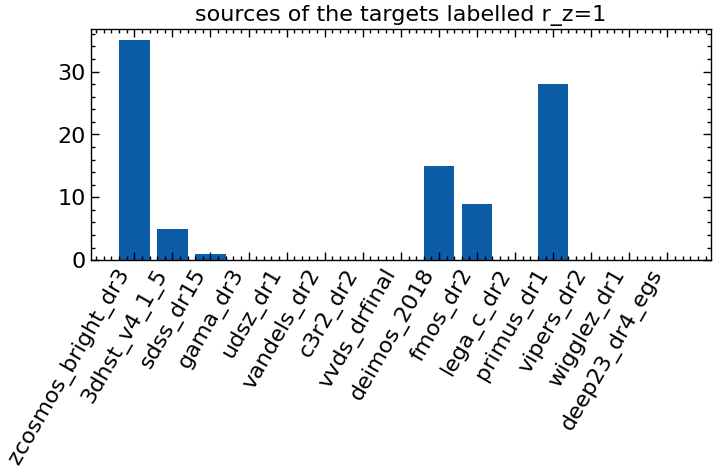

In [22]:
data_hsc_mask = data_agn_updated['r_z'] == 1
data_coords = SkyCoord(data_agn_updated['RAdeg'], data_agn_updated['DEdeg'], unit=[u.deg, u.deg])

source_keys = ['specz_flag_zcosmos_bright_dr3', 'specz_flag_3dhst_v4_1_5', 'specz_flag_sdss_dr15', 'specz_flag_gama_dr3', 'specz_flag_udsz_dr1', 'specz_flag_vandels_dr2', 'specz_flag_c3r2_dr2', 'specz_flag_vvds_drfinal', 'specz_flag_deimos_2018', 'specz_flag_fmos_dr2', 'specz_flag_lega_c_dr2', 'specz_flag_primus_dr1', 'specz_flag_vipers_dr2', 'specz_flag_wigglez_dr1', 'specz_flag_deep23_dr4_egs']
hsc_targets = ascii.read('spec/420753.csv', converters={key: [ascii.convert_numpy(bool)] for key in source_keys})
hsc_coords = SkyCoord(hsc_targets['specz_ra'], hsc_targets['specz_dec'], unit=[u.deg, u.deg])
hsc_duplication_mask = hsc_targets['specz_duplicationflag']==10

idx_hsc_pdr3, idx_hsc_specz, d2d, _ = data_coords[data_hsc_mask].search_around_sky(hsc_coords, 0.5*u.arcsec)

hsc_sources = {}
for key in source_keys: 
    hsc_sources[key] = np.count_nonzero(hsc_targets[idx_hsc_pdr3][key])


plt.figure(figsize=[8, 3])
plt.bar([key[11:] for key in hsc_sources.keys()], hsc_sources.values())
plt.xticks(rotation=60, ha='right');
plt.title('sources of the targets labelled r_z=1');

TODO: check all the sources in HSC and download them

```
specz_flag_zcosmos_bright_dr3
specz_flag_3dhst_v4_1_5
specz_flag_sdss_dr15 
specz_flag_deimos_2018
specz_flag_fmos_dr2
specz_flag_primus_dr1
```


Still, most data that has a `phot-z` label in HSC paper has a spec-z coming from zCOSMOS and DEIMOS.

In HSC paper, the `phot-z` comes form Chandra catalog (`2016ApJ...817...34M`) or COSMOS2015 catalog (`2016ApJS..224...24L`). 

For Chandra catalog, seems like 41% of its redsfhit is actually spec-z (chapter 6.1). 



## SDSS 

Download the spectra and label the table at once: 

In [23]:
idx_data = []
sdss_targets = []

for i in range(len(data_agn_updated)): 
    pos = data_coords[i]
    xid = SDSS.query_region(pos, radius='3 arcsec', spectro=True)
    if xid is None: 
        continue
    if len(xid)>=2: 
        print(i+1, 'has multiple spectra: ')
        xid.pprint_all()
    # else: 
    #     print(i+1, 'has a spectrum')
    sdss_targets.append(xid)
    idx_data.append(i)

len(idx_data)


/home/chisen/anaconda3/envs/py39-wsl2/lib/python3.9/site-packages/astroquery/sdss/core.py:874: VisibleDeprecationWarning: Reading unicode strings without specifying the encoding argument is deprecated. Set the encoding, use None for the system default.
  arr = np.atleast_1d(np.genfromtxt(io.BytesIO(response.content),


280 has multiple spectra: 
       ra              dec               objid        run  rerun camcol field    z     plate  mjd  fiberID      specobjid       run2d 
---------------- ---------------- ------------------- ---- ----- ------ ----- -------- ----- ----- ------- ------------------- -------
149.649923129421 1.86584454406202 1237653664721797334 1907   301      3   180 2.937933   500 51994     176  562998365386729472      26
149.649923129421 1.86584454406202 1237653664721797334 1907   301      3   180 2.934213  4737 55630     302 5333470966298157056 v5_10_0
283 has multiple spectra: 
       ra              dec               objid        run  rerun camcol field    z     plate  mjd  fiberID      specobjid       run2d 
---------------- ---------------- ------------------- ---- ----- ------ ----- -------- ----- ----- ------- ------------------- -------
149.744499096753 2.02749573426898 1237653664721862790 1907   301      3   181 2.446672   500 51994     513  563090999241369600      26
1

58

fill in the table

In [24]:
data_agn_download['spec_sdss'] = False
data_agn_download['z_sdss'] = -1. 
for i in range(len(idx_data)): 
    data_agn_download['spec_sdss'][idx_data[i]] = True
    data_agn_download['z_sdss'][idx_data[i]] = sdss_targets[i]['z'][-1]

download the spectra

In [25]:
# sdss_dir = 'spec/SDSS'
# for i in range(len(idx_data)): 
#     sp = SDSS.get_spectra(matches=sdss_targets[i])
#     sp[-1].writeto(os.path.join(sdss_dir, 'sdss_'+str(data_agn_download[idx_data][i]['ID'])+'.fits'), overwrite=True) # if more than 1, then the last one (-1) is probably the newest

Notes: 
* ID=283 and 280 have 2 spectra at its coordinate but their data are very close 
* If we change radius to 3 arcsec we can get more result with no overlapping 

## FMOS

https://member.ipmu.jp/fmos-cosmos/FC_spectra.html

catalog: FMOS_COSMOS_v1.0.fits

spectrum: 1dspec.tar.gz

J-long: 1.11-1.35um

H-long: 1.60–1.80um

In [26]:
fmos_targets = table.Table.read('./spec/FMOS_COSMOS_v1.0.fits')

fmos_coords = SkyCoord(fmos_targets['RA'], fmos_targets['DEC'], unit='deg')

idx_fmos, idx_data, d2d, _ = data_coords.search_around_sky(fmos_coords, 0.5*u.arcsec)

len(idx_fmos), len(np.unique(idx_data))

(13, 13)

fill in the table

In [27]:
data_agn_download['spec_fmos'] = False
data_agn_download['z_fmos'] = -1. 
for i, j in zip(idx_fmos, idx_data): 
    data_agn_download['spec_fmos'][j] = True
    if fmos_targets[i]['ZSPEC']!=-999.: 
        data_agn_download['z_fmos'][j] = fmos_targets[i]['ZSPEC']

# data_agn_download.pprint_all()

"Download" spectra (copy the matched spectra to the folder)

uncomment if needed to do it again

In [28]:
# fmos_from_dir = 'spec/1dspec/'
# fmos_to_dir = 'spec/FMOS/'
# os.makedirs(fmos_to_dir, exist_ok=True)

# for i, j in zip(idx_fmos, idx_data): 
#     # fetch HL
#     from_filename = fmos_targets[i]['FMOS_ID']+'_'+fmos_targets[i]['DATE_OBS_HL']+'_hl_1d.fits'
#     to_filename = 'fmos_'+str(j+1)+'_hl.fits'
#     if os.path.isfile(os.path.join(fmos_from_dir, from_filename)):
#         print('copied: ', from_filename, end=', ')
#         shutil.copy(os.path.join(fmos_from_dir, from_filename), os.path.join(fmos_to_dir, to_filename))
#     else: 
#         print('no file:', from_filename, end=', ')
#     # fetch JL
#     from_filename = fmos_targets[i]['FMOS_ID']+'_'+fmos_targets[i]['DATE_OBS_JL']+'_jl_1d.fits'
#     to_filename = 'fmos_'+str(j+1)+'_jl.fits'
#     if os.path.isfile(os.path.join(fmos_from_dir, from_filename)):
#         print('copied: ', from_filename)
#         shutil.copy(os.path.join(fmos_from_dir, from_filename), os.path.join(fmos_to_dir, to_filename))
#     else: 
#         print('no file:', from_filename)


## LEGA-C

https://users.ugent.be/~avdrwel/research.html



In [29]:
legac_targets = table.Table.read('spec/legac_dr3_cat.fits')

legac_coords = SkyCoord(legac_targets['RA'], legac_targets['DEC'], unit='deg')

idx_legac, idx_data, d2d, _ = data_coords.search_around_sky(legac_coords, 0.5*u.arcsec)

# has multiple spectra for same source
len(idx_legac), len(np.unique(idx_data))

(44, 36)

fill in the table

In [30]:
data_agn_download['spec_legac'] = False
data_agn_download['z_legac'] = -1. 
for i, j in zip(idx_legac, idx_data): 
    data_agn_download['spec_legac'][j] = True
    if legac_targets[i]['Z_SPEC']!=-99.:
        data_agn_download['z_legac'][j] = legac_targets[i]['Z_SPEC']

"Download" spectra (copy the matched spectra to the folder)

uncomment if needed to do it again

In [31]:
# fmos_from_dir = 'spec/legac_dr3_spectra/spectraDR'
# fmos_to_dir = 'spec/LEGA-C'
# os.makedirs(fmos_to_dir, exist_ok=True)

# for i, j in zip(idx_legac, idx_data): 
#     # fetch HL
#     from_filename = 'legac_M'+str(int(legac_targets[i]['MASK']))+'_'+str(int(legac_targets[i]['ID']))+'_v3.0.fits'
#     to_filename = 'legac_'+str(j+1)+'_M'+str(int(legac_targets[i]['MASK']))+'.fits'
#     if os.path.isfile(os.path.join(fmos_from_dir, from_filename)):
#         print('copied: ', from_filename)
#         shutil.copy(os.path.join(fmos_from_dir, from_filename), os.path.join(fmos_to_dir, to_filename))
#     else: 
#         print('no file:', from_filename)

## Summary

Check how many spectra each target has: 

In [32]:
data_agn_download.pprint_all()

 ID   RAdeg    DEdeg  i-mag X-flag g-flag r-flag i-flag z-flag n-corr ID-COSMOS2015      z      z_phot    z0         z1       z2   z3    z4    z5  r_z r_z0 r_z1 r_z4 spec_magellan z_magellan spec_zcosmos z_zcosmos spec_deimos z_deimos spec_3dhst z_3dhst spec_desi   z_desi   spec_sdss   z_sdss  spec_fmos       z_fmos       spec_legac z_legac
--- --------- ------- ----- ------ ------ ------ ------ ------ ------ ------------- ----------- ------ -------- ----------- ----- ---- ----- ----- --- ---- ---- ---- ------------- ---------- ------------ --------- ----------- -------- ---------- ------- --------- ---------- --------- --------- --------- ------------------ ---------- -------
  1 150.74386 2.20245 22.71      1      1      1      1      1      6        594392        1.58   1.58     -1.0        -1.0  -1.0 1.58 1.561  -1.0   3   -1   -1    3         False       -1.0        False      -1.0       False     -1.0      False    -1.0     False       -1.0     False      -1.0     False          

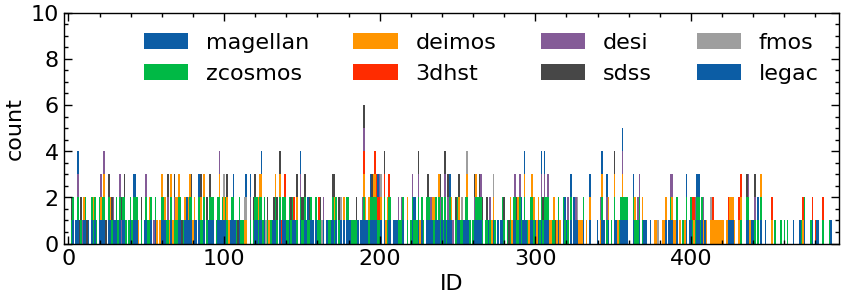

In [33]:
plt.figure(figsize=[10, 3])
spectra_counts = np.zeros(len(data_agn_download))
for flag in ['spec_magellan', 'spec_zcosmos', 'spec_deimos', 'spec_3dhst', 'spec_desi', 'spec_sdss', 'spec_fmos', 'spec_legac']: 
    plt.bar(data_agn_download['ID'], data_agn_download[flag], width=1, bottom=spectra_counts, label=flag[5:])
    spectra_counts += data_agn_download[flag]
plt.xlabel('ID')
plt.ylabel('count')
plt.legend(ncol=4)
plt.xlim(-3, 495)
plt.ylim(0, 10);

Visually check if most of the targets having more than 2 spectra is consistent

In [38]:
z_list = ['z_magellan', 'z_zcosmos', 'z_deimos', 'z_sdss', 'z_3dhst', 'z_desi', 'z_fmos', 'z_legac']
z_count = np.sum([data_agn_download[z]!=-1. for z in z_list], axis=0)
# data_agn_download[z_count==2][['ID'] + z_list].pprint_all()
# data_agn_download[z_count==3][['ID'] + z_list].pprint_all()
# data_agn_download[z_count==4][['ID'] + z_list].pprint_all()

data_inconsistent_spec = table.Table(names=(['ID']+z_list), dtype=([np.int64]+[np.float64]*len(z_list)))
for ID in range(len(data_agn_download)): 
    z = data_agn_download[ID][z_list]
    z_filtered = [i for i in z if i!=-1.]
    if z_filtered!=[]: 
        if np.max(z_filtered)-np.min(z_filtered)>0.1: 
            data_inconsistent_spec.add_row(data_agn_download[ID][['ID'] + z_list])
            # print(data_agn_download[ID][['ID'] + z_list])
data_inconsistent_spec.pprint_all()

 ID z_magellan z_zcosmos z_deimos z_sdss z_3dhst   z_desi   z_fmos z_legac
--- ---------- --------- -------- ------ ------- ---------- ------ -------
 27     0.9736      -1.0    1.634   -1.0    -1.0       -1.0   -1.0    -1.0
 29     1.1461      -1.0     -1.0   -1.0    -1.0   0.212926   -1.0    -1.0
164     0.5735      -1.0     -1.0   -1.0    -1.0  0.7315123   -1.0    -1.0
197       0.34     2.446    2.444   -1.0    -1.0       -1.0   -1.0    -1.0
205       -1.0    2.1873    0.528   -1.0    -1.0       -1.0   -1.0    -1.0
212       -1.0    1.5695     -1.0   -1.0    -1.0  0.8083875   -1.0    -1.0
214       -1.0    0.4368     -1.0   -1.0    -1.0 0.69758505   -1.0    -1.0
221     0.3236     0.735     -1.0   -1.0    -1.0 0.73498094   -1.0    -1.0
227     0.4586    1.5668     -1.0   -1.0    -1.0       -1.0   -1.0    -1.0
273     0.4311      -1.0    1.596   -1.0    -1.0       -1.0   -1.0    -1.0
306     1.7715      -1.0     -1.0   -1.0    -1.0 0.37035826   -1.0  1.7596
319       -1.0    1.1102 

### Vizualize spectra

Seems like zCOSMOS, SDSS, DESI are usually good.

Flux calibration of Magellan spectra is often too high, and DEIMOS flux calibration is usually bad.

In [44]:
line_cen = np.array( [6564.60,            4862.68,    2797,    1908, 1549.06, 1215.67])
line_name = np.array([r'H$\alpha$+[NII]', r'H$\beta$','MgII'  , 'CIII]', 'CIV',   r'Ly$\alpha$'])

wmin = 4000
wmax = 11000

# # for i, ID in enumerate(data_agn_download['ID'][z_count>=2]): 
# for i,ID in enumerate(data_inconsistent_spec['ID']):
# # for i,ID in enumerate(data_agn_download['ID'][252:256]):
    
def visualize(ID):

    ra = data_agn_download['RAdeg'][data_agn_download['ID']==ID].data[0]
    dec = data_agn_download['DEdeg'][data_agn_download['ID']==ID].data[0]

    fig, ax = plt.subplots(1,1, figsize=(8,4.5))
    
    # Template data
    hdutemp = SDSS.get_spectral_template('qso')[0]
    datatemp = hdutemp[0].data
    headertemp = hdutemp[0].header
    start, stop, num = headertemp['COEFF0'], headertemp['COEFF0']+headertemp['COEFF1']*datatemp[1].size, datatemp[1].size
    
    ylim = 0
    z_zcosmos = -1
    z_magellan = -1
    z_deimos = -1
    z_sdss = -1
    z_desi = -1
    z_3dhst = -1
    z_legac = -1
    

    # zCOSMOS
    if os.path.isfile('spec/zCOSMOS/zcosmos_%d.fits'%ID): 

        z_zcosmos = data_agn_download['z_zcosmos'][ID-1]

        hdu0 = fits.open('spec/zCOSMOS/zcosmos_%d.fits'%ID)
        #print(hdu1[0].header)
        data0 = hdu0[1].data
        # mask
        #data1_mask = np.full(data1[1].shape, np.nan)
        #data1_mask[data1[3]>0] = data1[1][data1[3]>0]
        flux_zcosmos = convolve(data0['FLUX_REDUCED'][0]/1e-17, Box1DKernel(width=10))
        flux_err_zcosmos = convolve(0.1*data0['FLUX_REDUCED'][0]/1e-17, Box1DKernel(width=10))
        
        ax.plot(data0['WAVE'][0], flux_zcosmos, 
                label=f'zCOSMOS (z={z_zcosmos})', color='coral', linewidth=1, alpha=0.5)
        #plt.fill_between(data1[0], flux_magellean-flux_err_magellean, flux_magellean+flux_err_magellean,
        #                 color='skyblue', linewidth=0, alpha=0.1)
        
        mask = np.isfinite(flux_zcosmos)
        ylim = np.max([ylim, np.nanmax(flux_zcosmos[mask])])
        z_zcosmos = data_agn_download['z_zcosmos'][ID-1]
    

    # Magellan
    if os.path.isfile('spec/Magellan/magellan_%d.fits'%ID): 

        z_magellan = data_agn_download['z_magellan'][ID-1]

        hdu1 = fits.open('spec/Magellan/magellan_%d.fits'%ID)
        #print(hdu1[0].header)
        data1 = hdu1[0].data
        # mask
        data1_mask = np.full(data1[1].shape, np.nan)
        data1_mask[data1[3]>0] = data1[1][data1[3]>0]
        flux_magellan = convolve(data1_mask/1e-17, Box1DKernel(width=10))
        flux_err_magellan = convolve(data1[2], Box1DKernel(width=10))
        ax.plot(data1[0], flux_magellan, 
                label=f'Magellan (z={z_magellan})', color='deepskyblue', linewidth=1, alpha=0.5)
        #plt.fill_between(data1[0], flux_magellean-flux_err_magellean, flux_magellean+flux_err_magellean,
        #                 color='skyblue', linewidth=0, alpha=0.1)
        
        mask = np.isfinite(flux_magellan)
        ylim = np.max([ylim, np.nanmax(flux_magellan[mask])])


    # DEIMOS
    if os.path.isfile('spec/DEIMOS/deimos_%d.fits'%ID): 

        z_deimos = data_agn_download['z_deimos'][ID-1]

        hdu3 = fits.open('spec/DEIMOS/deimos_%d.fits'%ID)
        #print(hdu3[0].header)
        data3 = hdu3[1].data
        # if 'FLUX' in data3.names:
        #     continue
        flux_deimos = convolve(data3['FLUX'][0]*1e-19/1e-17, Box1DKernel(width=20))
        #flux_err_deimos = convolve(1/np.sqrt(data3['IVAR'][0])*1e-19/1e-17, Box1DKernel(width=50))
        # No error providede, assume ~10%
        flux_err_deimos = 0.1*flux_deimos
        
        ax.plot(data3['LAMBDA'][0], flux_deimos, 
                label=f'DEIMOS (z={z_deimos})', color='orchid', linewidth=1, alpha=0.5)
        #plt.fill_between(data3['LAMBDA'][0], flux_deimos-flux_err_deimos, flux_deimos+flux_err_deimos,
        #                 color='forestgreen', linewidth=0, alpha=0.1)
        
        mask = np.isfinite(flux_deimos)
        ylim = np.max([ylim, np.nanmax(flux_deimos[mask])])

                
    # SDSS
    
    if os.path.isfile('spec/SDSS/sdss_%d.fits'%ID): 
        
        z_sdss = data_agn_download['z_sdss'][ID-1]

        hdu = fits.open('spec/SDSS/sdss_%d.fits'%ID)
        mask = np.isfinite(hdu[1].data['flux'])
        flux_sdss = convolve(hdu[1].data['flux'][mask], Box1DKernel(width=10))
        ax.plot(10**hdu[1].data['loglam'][mask], flux_sdss,
                 label=f'SDSS (z={z_sdss})', color='bisque', linewidth=1);
        
        mask = np.isfinite(flux_sdss)
        ylim = np.max([ylim, np.nanmax(flux_sdss[mask])])
        

    # DESI
    if os.path.isfile('spec/desi/desi_%d.txt'%ID): 

        z_desi = data_agn_download['z_desi'][ID-1]
        
        data_spec = ascii.read('spec/desi/desi_%d.txt'%ID)
        flux_desi = convolve(data_spec['col2'], Box1DKernel(width=10))
        ax.plot(data_spec['col1'], flux_desi,
                 label=f'DESI (z={z_desi})', color='g', linewidth=1);
        
        mask = np.isfinite(flux_desi)
        ylim = np.max([ylim, np.nanmax(flux_desi[mask])])


    # 3D-HST
    if os.path.isfile('spec/3D HST/3dhst_%d.fits'%ID): 

        z_3dhst = data_agn_download['z_3dhst'][ID-1]
        
        hdu = fits.open('spec/3D HST/3dhst_%d.fits'%ID)
        flux_3dhst = hdu[1].data['flux']*hdu[1].data['sensitivity']
        ax.plot(hdu[1].data['wave'], flux_3dhst,
                 label=f'3D-HST (z={z_3dhst})', color='b', linewidth=1);
        
        mask = np.isfinite(flux_3dhst)
        ylim = np.max([ylim, np.nanmax(flux_3dhst[mask])])


    # NOTE: FMOS are NIR spectra, not optical
    # # FMOS hl
    # if os.path.isfile('spec/FMOS/fmos_%d_hl.fits'%ID): 

    #     hdu0 = fits.open('spec/FMOS/fmos_%d_hl.fits'%256)
        
    #     flux_fmos = convolve(hdu0[0].data, Box1DKernel(width=5))
    #     x_start = hdu0[0].header['CRVAL1'] # 15600
    #     x_stop = hdu0[0].header['CRVAL1'] + hdu0[0].header['NAXIS1']*hdu0[0].header['CD1_1'] # 15600+1920*1.25
    #     x_step = hdu0[0].header['CD1_1'] # 1.25
    #     ax.plot(np.arange(x_start, x_stop, x_step), flux_fmos, 
    #             label='FMOS', color='orangered', linewidth=1, alpha=0.5)

    # # FMOS jl
    # if os.path.isfile('spec/FMOS/fmos_%d_jl.fits'%ID): 

    #     hdu0 = fits.open('spec/FMOS/fmos_%d_jl.fits'%256)
        
    #     flux_fmos = convolve(hdu0[0].data, Box1DKernel(width=5))
    #     x_start = hdu0[0].header['CRVAL1'] # 11230
    #     x_stop = hdu0[0].header['CRVAL1'] + hdu0[0].header['NAXIS1']*hdu0[0].header['CD1_1'] # 11230+1920*1.25
    #     x_step = hdu0[0].header['CD1_1'] # 1.25
    #     ax.plot(np.arange(x_start, x_stop, x_step), flux_fmos, label='FMOS',
    #             color='orangered', linewidth=1, alpha=0.5)
        
    #     ylim = np.max([ylim, 10])


    # LEGA-C
    for legac_mask in list(range(1, 33))+list(range(101, 103)): 
        if os.path.isfile('spec/LEGA-C/legac_%d_M%d.fits'%(ID, legac_mask)):
            
            z_legac = data_agn_download['z_legac'][ID-1]

            hdu0 = fits.open('spec/LEGA-C/legac_%d_M%d.fits'%(ID, legac_mask))
            ax.plot(hdu0[1].data['WAVE'][0], hdu0[1].data['FLUX'][0]*1e-2, 
                    label=f'LEGA-C (z={z_legac})', color='navy', linewidth=1, alpha=0.5)




        
    ax.set_xlim(wmin, wmax)
    ax.set_ylim(0.0, 1.2*ylim)
        
    # TEMPLATES
    # Line position
    axis_to_data = ax.transAxes + ax.transData.inverted()
    points_data = axis_to_data.transform((0, 0.92))
    
    for z in [z_zcosmos, z_magellan, z_deimos, z_sdss, z_desi, z_3dhst, z_legac]:
        # Template
        if z > 0:
            ax.plot(np.logspace(start, stop, num)*(1 + z), datatemp[1]/np.max(datatemp[1])*ylim, #np.nanmax(flux_deimos), 
                     label=f'template (z = {z})', linewidth=1, alpha=0.75, color='k', linestyle='-')

            for ll in range(len(line_cen)):
                if line_cen[ll]*(1 + z) > wmin and line_cen[ll]*(1 + z) < wmax:
                    ax.axvline(line_cen[ll]*(1 + z), 0, 5, linewidth=1, color='k', alpha=0.5)
                    ax.text(line_cen[ll]*(1 + z) + 7, points_data[1], line_name[ll], rotation=90, fontsize=10, va='top')
        
    ax.set_title(f'ID={ID}, RA={ra}, dec={dec}')
    ax.legend(fontsize=12, loc=2);
    
    ax.set_ylabel(r'$f_{\lambda}$ (erg s$^{-1}$ cm$^{-2}$ $\AA^{-1})$')
    ax.set_xlabel(r'Wavelength ($\AA$)')
    

First group of plot: redshift recorded in spectrum not consistent


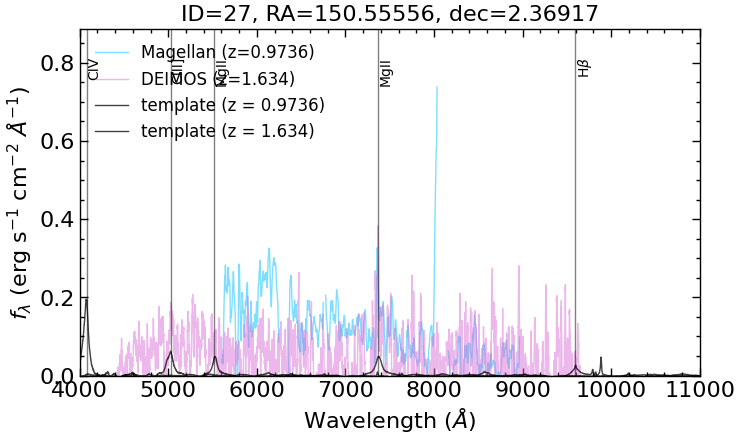

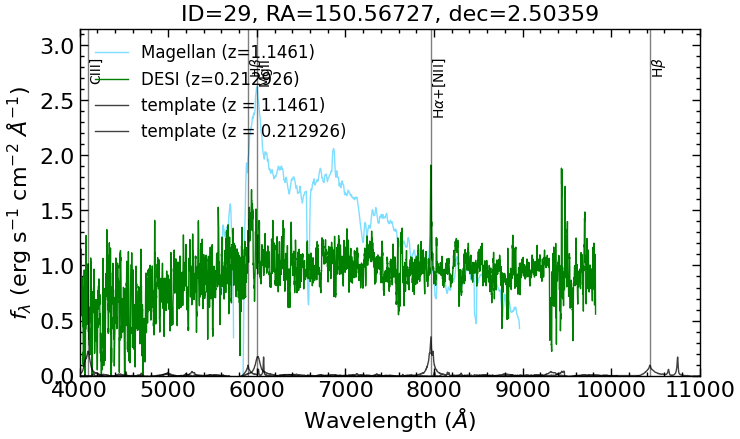

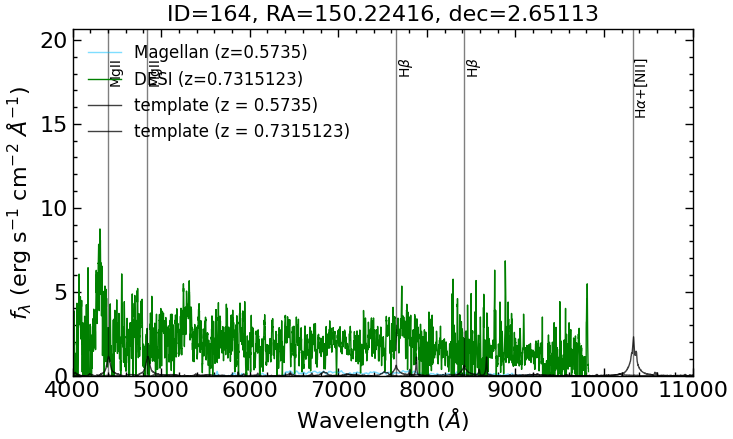

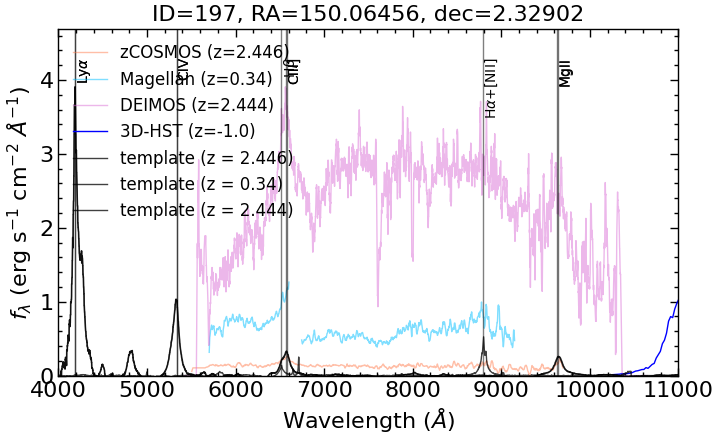

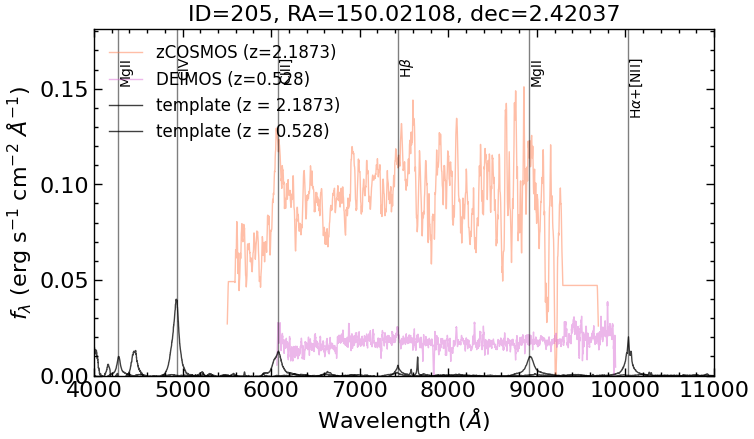

...

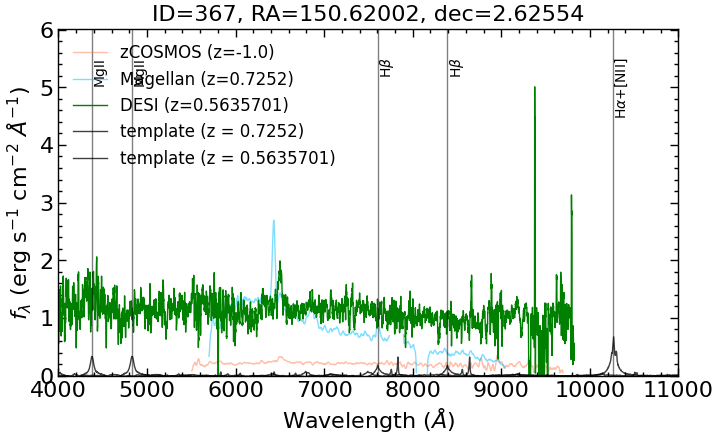

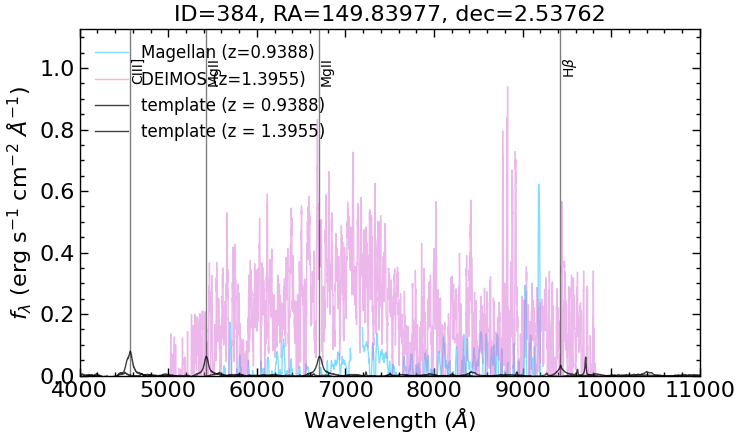

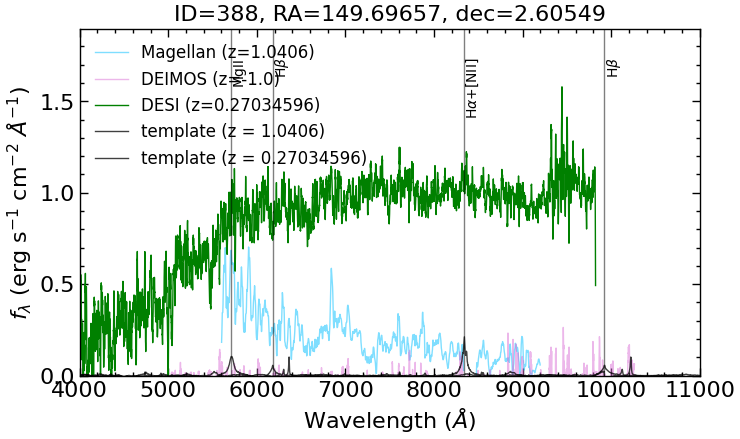

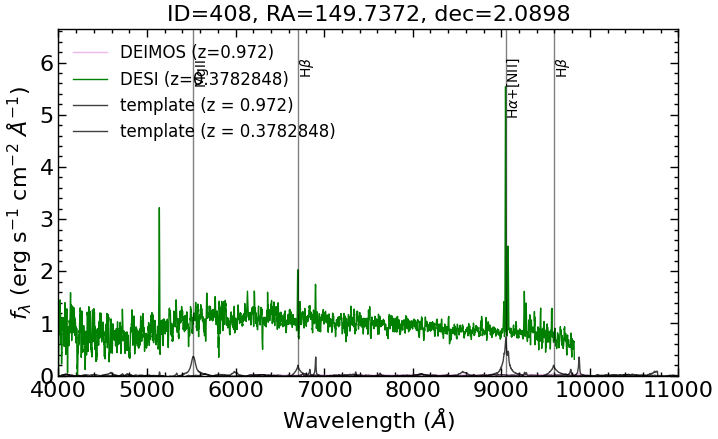

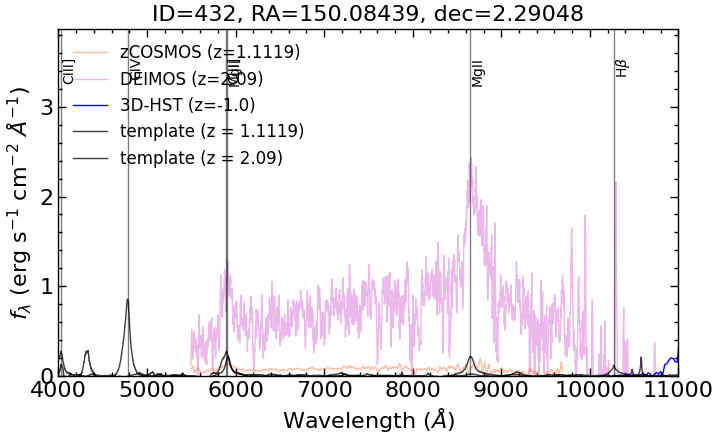

In [45]:
for ID in data_inconsistent_spec['ID']:
    visualize(ID)

Second group of plot: inconsistent z in `updated` table

manually check inconsistent zs

```
Original Chandra    -> z5
SIMBAD              -> z0
HSC DR3             -> z1
COSMOS2020          -> z3 -> do not inspect (photz)
```

 ID    z0        z1       z5 
--- ------- ----------- -----
 11   0.925      1.5652  -1.0
 17  1.2651      2.3219  -1.0
 27  0.9736       1.634  -1.0
 40  1.1433      0.4924  -1.0
 76  0.8913   1.5563668  -1.0
 90  1.2995  0.42066365  -1.0
103   1.606   0.4906261  -1.0
127   1.797   1.0733103  -1.0
137  2.1458     1.40008  -1.0
139  1.5145      1.9289  -1.0
145  0.9793      1.7592  -1.0
153   0.695    1.001973  -1.0
193   2.673 0.045087364  -1.0
197    0.34      1.9582  -1.0
201  1.8456 0.090319805  -1.0
206  0.4967      0.6911  -1.0
210  0.6312        -1.0 1.233
221  0.3236      0.7344  -1.0
223 0.74829      0.5773  -1.0
227  0.4586      1.5659  -1.0
237  2.6681  0.13425398  -1.0
256  1.4797   0.3996155  -1.0
257  0.4319   1.0107826  -1.0
270  1.7977   0.8445786  -1.0
273  0.4311       1.596  -1.0
276  0.4682        -1.0 1.782
292  0.5368   0.9435049  -1.0
300    4.17   0.2762015  -1.0
331  0.7284      2.2335  -1.0
367  0.7252      1.3247  -1.0
384  0.9388      1.3955  -1.0
400   0.94

FLUX                                                                             [astropy.io.fits.card]
IVAR                                                                             [astropy.io.fits.card]
/tmp/ipykernel_12270/2386915601.py:191: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(0.0, 1.2*ylim)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/tmp/ipykernel_12270/2386915601.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,1, figsize=(8,4.5))


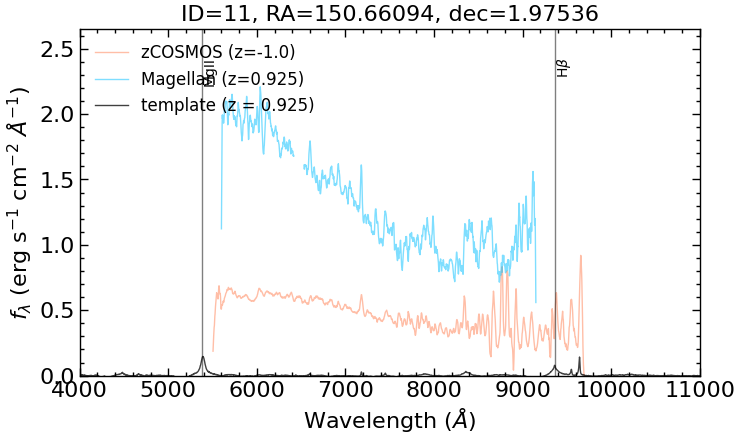

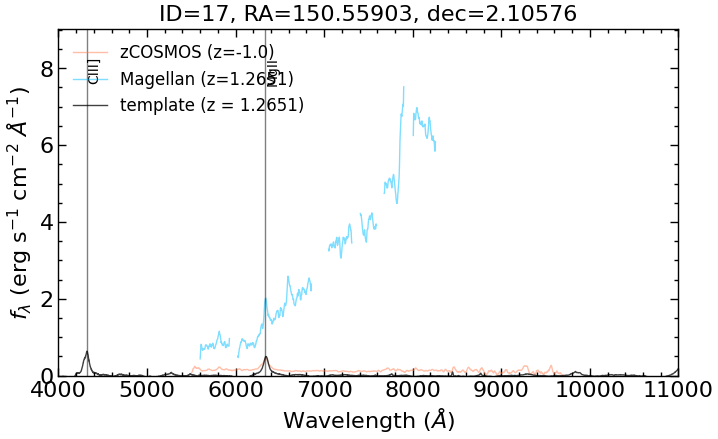

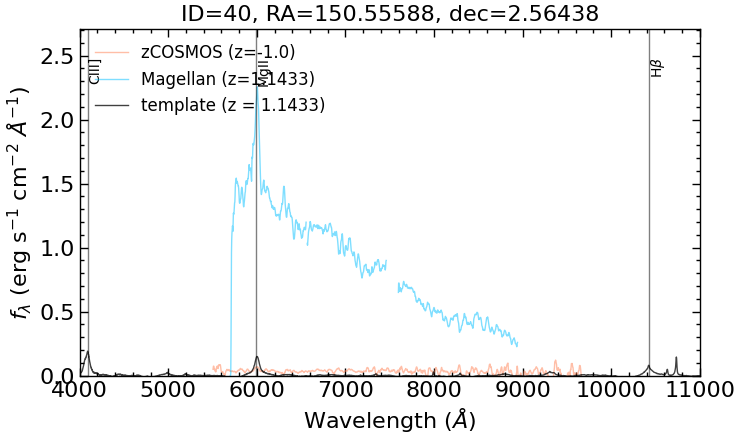

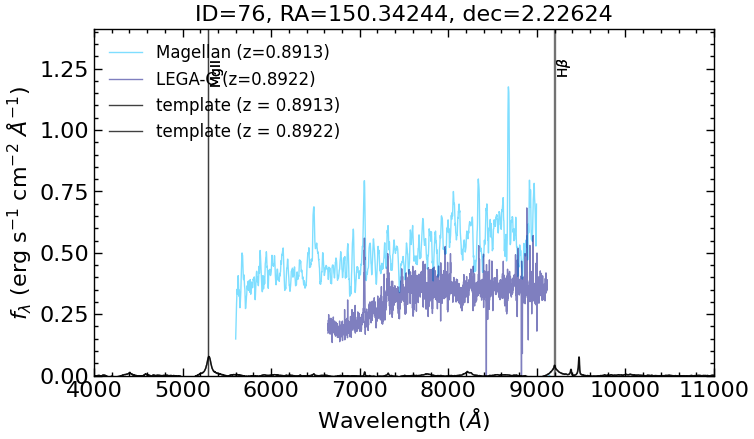

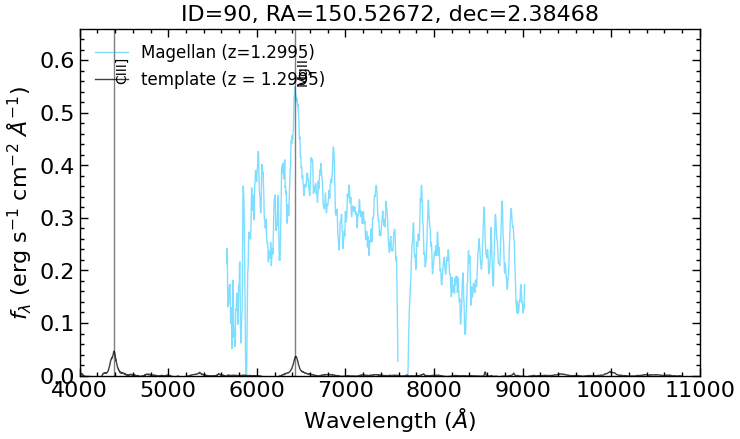

...

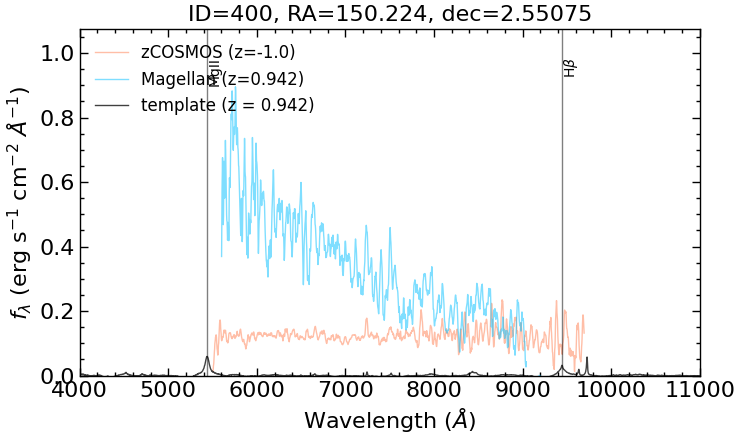

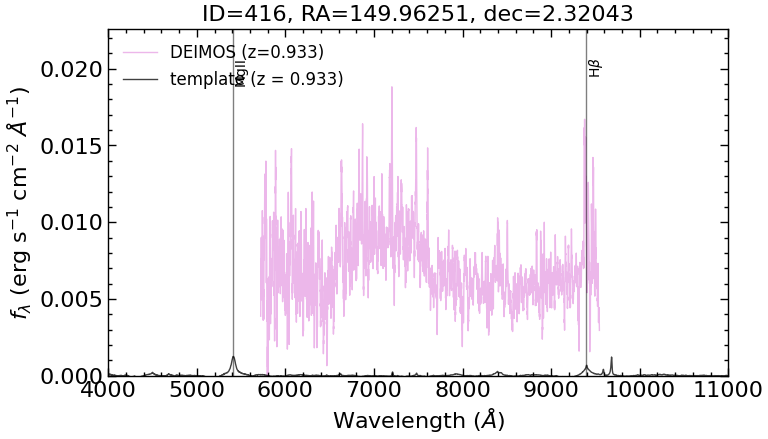

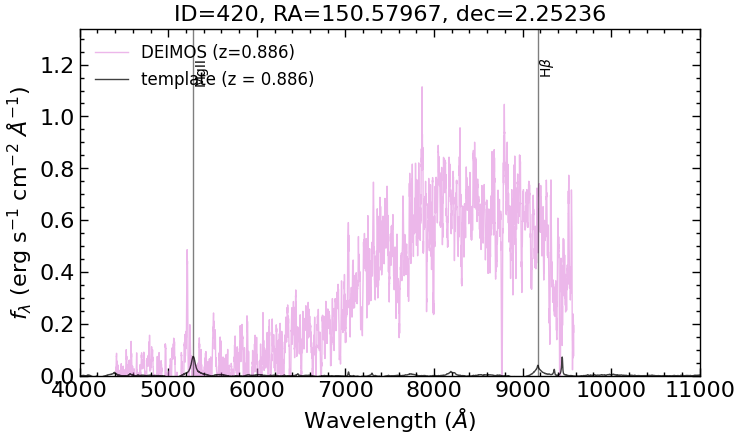

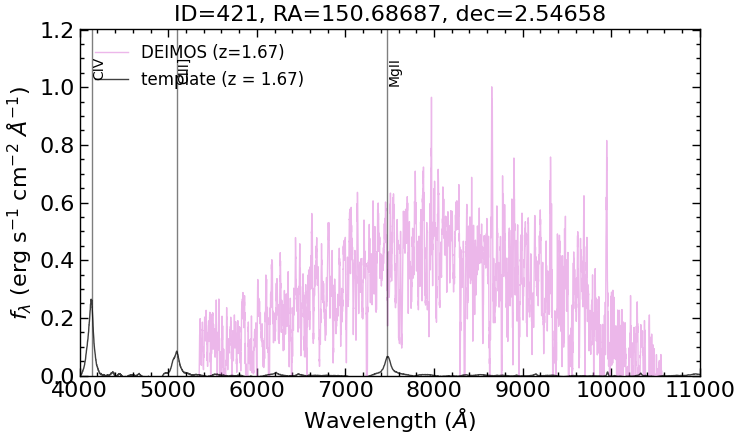

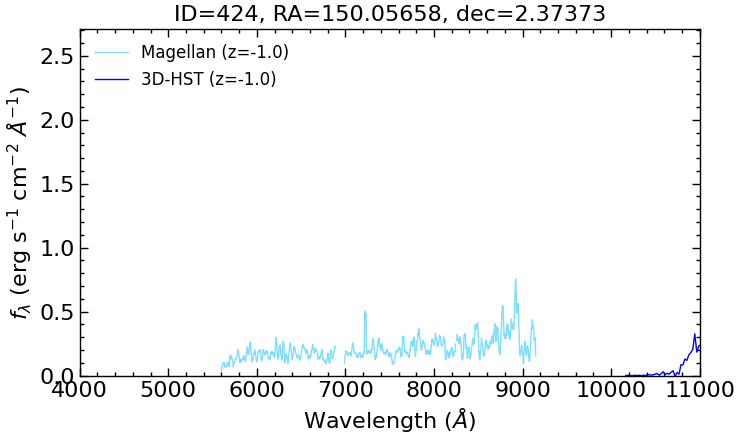

In [48]:
z_list = ['z0', 'z1', 'z5']
inconsistent_z = table.Table(names=(['ID']+z_list), dtype=([np.int64]+[np.float64]*len(z_list)))
for i in range(len(data_agn_updated)): 
    z = data_agn_updated[i][z_list]
    z_filtered = [j for j in z if j!=-1.]
    if z_filtered!=[]: 
        if np.max(z_filtered)-np.min(z_filtered)>0.1: 
            inconsistent_z.add_row(data_agn_updated[i][['ID'] + z_list])
            # print(data_agn_download[ID][['ID'] + z_list])
inconsistent_z.pprint_all()

for ID in inconsistent_z['ID']:
    if ID not in data_inconsistent_spec['ID']: 
        visualize(ID)

### Update to best redshift and save new file

In [ ]:
#data_agn_download.pprint_all()

In [ ]:
# data_agn_download['z'][data_agn_download['ID']==27] = data_agn_download['z_spec'][data_agn_download['ID']==27]  # Uncertain, use photo-z
# data_agn_download['r_z'][data_agn_download['ID']==27] = 2  # photo-z

# data_agn_download['z'][data_agn_download['ID']==197] = 2.444  # Certain

# data_agn_download['z'][data_agn_download['ID']==205] = data_agn_download['z_spec'][data_agn_download['ID']==205]  # Uncertain, use photo-z
# data_agn_download['r_z'][data_agn_download['ID']==205] = 2  # photo-z

# data_agn_download['z'][data_agn_download['ID']==221] = data_agn_download['z_spec'][data_agn_download['ID']==221]  # Uncertain, use photo-z
# data_agn_download['r_z'][data_agn_download['ID']==221] = 2  # photo-z

# data_agn_download['z'][data_agn_download['ID']==227] = data_agn_download['z_spec'][data_agn_download['ID']==227]  # Uncertain, use photo-z
# data_agn_download['r_z'][data_agn_download['ID']==227] = 2  # photo-z

# data_agn_download['z'][data_agn_download['ID']==273] = 1.596 # one line

# data_agn_download['z'][data_agn_download['ID']==289] = 1.531 # ???

# data_agn_download['z'][data_agn_download['ID']==331] = 2.2346 # one line

# data_agn_download['z'][data_agn_download['ID']==356] = data_agn_download['z_spec'][data_agn_download['ID']==356] # Uncertain, use photo-z
# data_agn_download['r_z'][data_agn_download['ID']==356] = 2  # photo-z

# data_agn_download['z'][data_agn_download['ID']==384] = data_agn_download['z_spec'][data_agn_download['ID']==384] # Uncertain, use photo-z
# data_agn_download['r_z'][data_agn_download['ID']==384] = 2  # photo-z

# data_agn_download['z'][data_agn_download['ID']==284] = 2.09 # Uncertain, use photo-z

# data_agn_download
# data_agn_download.write('hsc_agn_download.txt', format='ascii', overwrite=True)

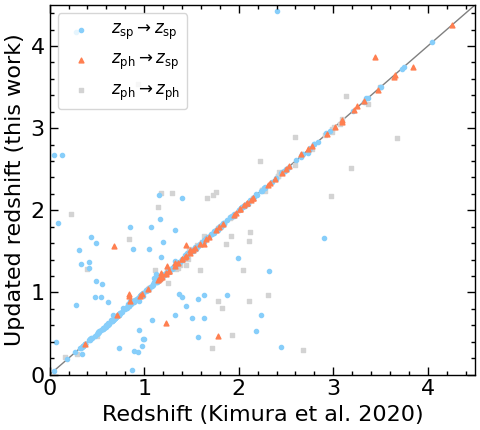

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(5, 4.5))

mask_specz = data_agn['r_z'] < 3
ax.scatter(data_agn['z'][mask_specz], data_agn_download['z'][mask_specz], 
           marker='.', color='lightskyblue', label=r'$z_{\rm sp} \rightarrow z_{\rm sp}$')

num_spec = np.sum([data_agn_download[z]!=-1 for z in z_list], axis=0)
mask_specz = (data_agn['r_z'] >= 3) & (data_agn_download['r_z'] < 2)#(num_spec!=0)#
ax.scatter(data_agn['z'][mask_specz], data_agn_download['z'][mask_specz],
           marker='^', color='coral', s=12, label=r'$z_{\rm ph} \rightarrow z_{\rm sp}$')

mask_specz = data_agn_download['r_z'] > 1
ax.scatter(data_agn['z'][mask_specz], data_agn_download['z'][mask_specz],
           marker='s', label=r'$z_{\rm ph} \rightarrow z_{\rm ph}$', color='lightgray', s=6, zorder=-1)

ax.plot([0, 4.5], [0, 4.5], lw=1, zorder=-2, color='gray')

ax.set_xlabel('Redshift (Kimura et al. 2020)')
ax.set_ylabel('Updated redshift (this work)')
ax.legend(frameon=True, loc=2, fontsize=12)
ax.set_xlim(0, 4.5)
ax.set_ylim(0, 4.5)
fig.savefig('specz.pdf', dpi=300)

fig.tight_layout()

In [ ]:
## Check the grating

SDSS template AGN spectrum: 

template spectra: https://classic.sdss.org/dr5/algorithms/spectemplates/

HDU description: https://classic.sdss.org/dr5/dm/flatFiles/spSpec.html 

One consistent target: 

1.8347


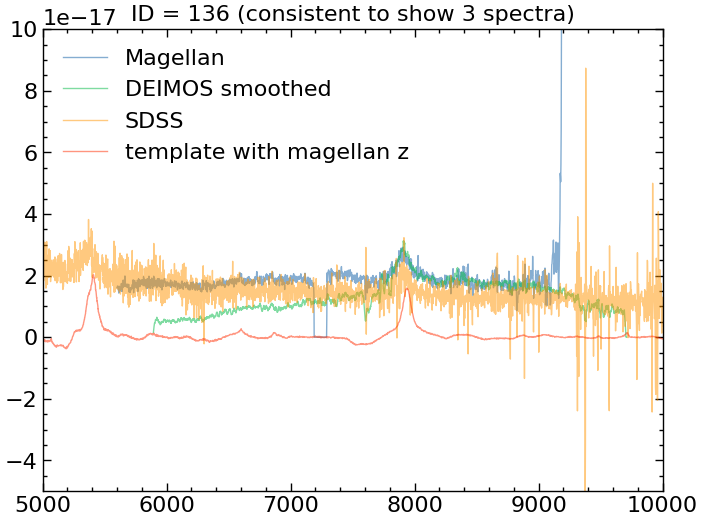

In [ ]:
# ID = 136

# Magellean
hdu1 = fits.open('spec/Magellan/magellan_136.fits')
data1 = hdu1[0].data
plt.plot(data1[0], data1[1], label='Magellan', linewidth=1, alpha=0.5)

# DEIMOS
hdu3 = fits.open('spec/DEIMOS/deimos_136.fits')
data3 = hdu3[1].data
box1d_kernel = Box1DKernel(width=30)
flux = convolve(data3['FLUX'][0]*1e-19, box1d_kernel)
plt.plot(data3['LAMBDA'][0], flux, label='DEIMOS smoothed', linewidth=1, alpha=0.5)
# plt.plot(data3['LAMBDA'][0], data3['FLUX'][0]*1e-18, label='DEIMOS', linewidth=0.1)

# SDSS
hdu = fits.open('spec/SDSS/sdss_136.fits')
plt.plot(10**hdu[1].data['loglam'], hdu[1].data['flux']*1e-17, label='SDSS', linewidth=1, alpha=0.5);

# template
hdutemp = SDSS.get_spectral_template('qso')[0]
datatemp = hdutemp[0].data
headertemp = hdutemp[0].header
start, stop, num = headertemp['COEFF0'], headertemp['COEFF0']+headertemp['COEFF1']*datatemp[1].size, datatemp[1].size
z_magellean = data_agn_download['z_magellan'][135]
print(z_magellean)
plt.plot(np.logspace(start, stop, num)*(1+z_magellean), datatemp[1]*1e-17, label='template with magellan z', linewidth=1, alpha=0.5)

plt.title('ID = 136 (consistent to show 3 spectra)')
plt.xlim(5000, 10000)
plt.ylim(-0.5e-16, 1e-16)
plt.legend();